## Team 2

**Project Title** - Predicting House value based on several house and surrounding attributes

#### Team Members
* Prateek Vachher
* Sunny Parawala
* Windy Zheng

In [1]:
import requests
import folium
import pickle

import numpy as np
import matplotlib.pylab as plt
import seaborn as sns
import pandas as pd

from folium import plugins
from textblob import TextBlob

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
df = pickle.load(open("datafiles/cleandata.ft", "rb"))
df.head()

,totPurchaseAmt,bathrooms,bedrooms,livingArea,yearBuilt,lotSize,averageSchoolRating,zip,description,zestimate
1,198000.0,2.0,4.0,1716.0,1996,10716,5.333333,55303,"14649 Iodine Ct NW, Ramsey, MN is a single fam...",285985.0
2,130000.0,2.0,4.0,864.0,1963,12100,5.666667,55448,"10921 Dogwood St NW, Coon Rapids, MN is a sing...",132773.0
4,329900.0,3.0,4.0,1814.0,2001,10018,6.500000,55038,"2372 Tart Lake Rd, Lino Lakes, MN is a single ...",318162.0
5,262000.0,2.0,3.0,2158.0,1985,12632,4.666667,55043,"This large rambler is located on a beautiful, ...",272169.0
7,237000.0,2.0,3.0,2058.0,1959,10890,3.666667,55432,"Great, Updated, Ready To Move In, Starter Home...",246844.0


In [17]:
len(df)

26372

### Sentiment Analysis

In [3]:
df["desc_sentiment"] = df["description"].apply(lambda x: TextBlob(x).sentiment.polarity)
df["desc_subjectivity"] = df["description"].apply(lambda x: TextBlob(x).sentiment.subjectivity)

In [4]:
print ("Maximum Sentiment Score:", df["desc_sentiment"].max())
print ("Minimum Sentiment Score:", df["desc_sentiment"].min())
print ("Average Sentiment of Description:", df["desc_sentiment"].mean())
print ("")
print ("Maximum Subjectivity Score:", df["desc_subjectivity"].max())
print ("Minimum Subjectivity Score:", df["desc_subjectivity"].min())
print ("Average Subjectivity of Description:", df["desc_subjectivity"].mean())

Maximum Sentiment Score: 1.0
Minimum Sentiment Score: -0.75
Average Sentiment of Description: 0.16148961563131575

Maximum Subjectivity Score: 1.0
Minimum Subjectivity Score: 0.0
Average Subjectivity of Description: 0.39154613781425046


### Correlation Matrix

<AxesSubplot:>

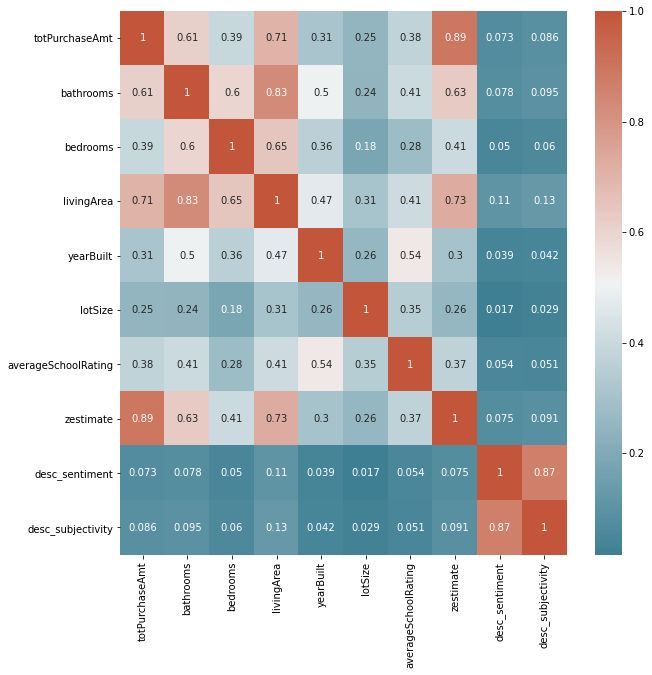

In [5]:
numericalData = df.drop(columns=["zip", "description"])

corr = numericalData.corr()    # plot the heatmap
plt.subplots(figsize=(10,10))
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, 
            cmap=sns.diverging_palette(220, 20, as_cmap=True))

* We see that **totPurchaseAmt and zestimate have a strong positive correlation**. That is expected since the zillow price prediction model is built on the totPurchaseAmt dataset

* We see that the **price of a house is positively correlated to the living area and the number of bathrooms**.

* We also see an interesting trend of the **average school rating being better near recently built houses**.

* As expected we see that an **increase in number of bedrooms in a house also increases the number of bathrooms**.

* The **description sentiment and subjectivity also shows a strong correlation**. A more positive sentiment description seems to be more subjective.

### ScatterPlots

<AxesSubplot:xlabel='averageSchoolRating', ylabel='totPurchaseAmt'>

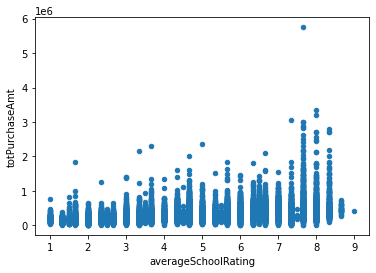

In [6]:
df.plot(kind='scatter', x='averageSchoolRating', y='totPurchaseAmt')

<AxesSubplot:xlabel='livingArea', ylabel='totPurchaseAmt'>

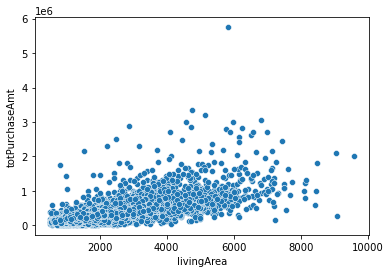

In [7]:
sns.scatterplot(x='livingArea', y='totPurchaseAmt', data=df)

<AxesSubplot:xlabel='bedrooms', ylabel='bathrooms'>

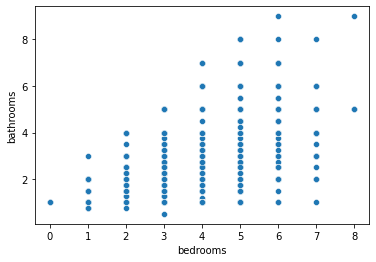

In [8]:
sns.scatterplot(x='bedrooms', y='bathrooms', data=df)

<AxesSubplot:xlabel='livingArea', ylabel='bedrooms'>

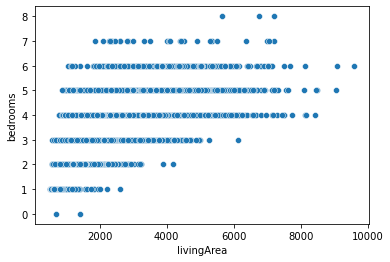

In [9]:
sns.scatterplot(x='livingArea', y='bedrooms', data=df)

### Regional Listing HeatMap

In [10]:
numListings = df.groupby('zip').count()

numListingsByZip = pd.DataFrame()

numListingsByZip["zip"] = [str(i) for i in numListings.index]
numListingsByZip["numListings"] = numListings["totPurchaseAmt"].values

In [11]:
jsonData = requests.get("https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/mn_minnesota_zip_codes_geo.min.json")
mnArea = jsonData.json()

In [12]:
mnMap = folium.Map(location=[44.9778, -93.2650], tiles="Stamen Toner", zoom_start=8)

mnMap.choropleth(geo_data=mnArea, data=numListingsByZip, columns=["zip", "numListings"], 
                 key_on='feature.properties.ZCTA5CE10', fill_color='YlGn', fill_opacity=1)
mnMap

### Deviation in Z-Estimate and Actual Price Listing

In [13]:
len(df[df["totPurchaseAmt"] > df["zestimate"]])

589

In [14]:
len(df[df["totPurchaseAmt"] == df["zestimate"]])

1

In [15]:
len(df[df["totPurchaseAmt"] < df["zestimate"]])

25782

In [16]:
difference = abs(df["totPurchaseAmt"] - df["zestimate"])
difference.mean()

47111.73207871984

We see that in majority of the cases, the zillow price estimatation model **over-estimated the price** of the house compared to how much it was actually bought for. Zillow has a **MAE of $47,111** for the clean filtered dataset we use for this project.